In [6]:
import torch.nn as nn
import healpy as hp 
import torch 
from CycleGAN1 import Generator , get_memory_loader 
import matplotlib.pyplot as plt
import numpy as np 
import pylab as pl 
import cmasher as cm 
def load_for_inference(checkpoint_path, input_shape=(2, 128, 128), generator= 'G_AB'):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    # Initialize the specific generator you want (usually A -> B)
    model = Generator(input_shape).to(device)
    
    # Load the file
    checkpoint = torch.load(checkpoint_path, map_location=device)
    
    # Extract only the Generator state
    # Note: Ensure the key matches what you saved ('G_AB' or 'G_BA')
    if generator in checkpoint:
        model.load_state_dict(checkpoint[generator ])
    else:
        # Fallback if you saved the whole model directly instead of a dict
        model.load_state_dict(checkpoint)
        
    model.eval() # Set to evaluation mode (turns off Dropout/Norm update)
    print("Generator loaded successfully for inference.")
    
    return model



In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
workdir ="/pscratch/sd/g/giuspugl/workstation/CO_network/" 
import glob 
import re
chks = (glob . glob (f"{workdir}/unpaired_training_norm/checkpoint_epoch_*" )) 
# Regex to extract the epoch number
def extract_epoch(filename):
    match = re.search(r"checkpoint_epoch_(\d+).pth", filename)
    
    return int(match.group(1)) if match else -1
    # Sort based on epoch number (Descending)

latest_chkp  = max(chks, key=extract_epoch)
#latest_chkp= f"{workdir}/extending_CO/new_experiment/checkpoint_epoch_700.pth"
#latest_chkp= f"{workdir}/unpaired_training_norm/checkpoint_epoch_720.pth"
G_AB = load_for_inference(latest_chkp, generator='G_AB' ) 
fileA= f'{workdir}/data/feature_file_test.pt'
fileB= f'{workdir}/data/target_file_test.pt'

print(latest_chkp ) 
# Usage:
G_AB.eval()

dataloader = get_memory_loader(fileA, fileB ,mode='paired',  batch_size=4) 



Generator loaded successfully for inference.
/pscratch/sd/g/giuspugl/workstation/CO_network//unpaired_training_norm/checkpoint_epoch_800.pth
Loading tensors...


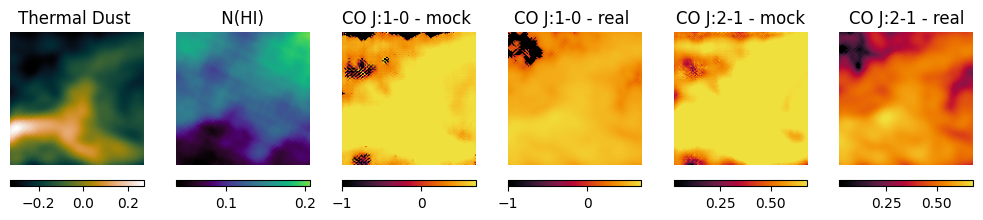

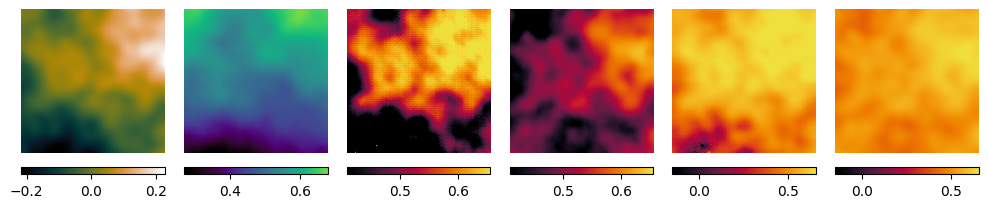

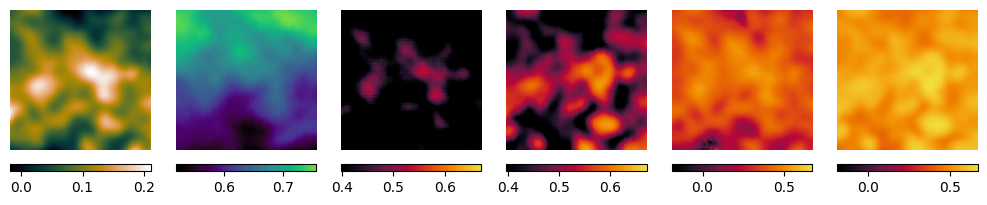

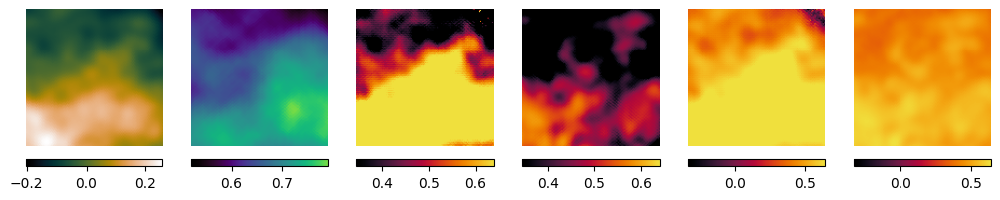

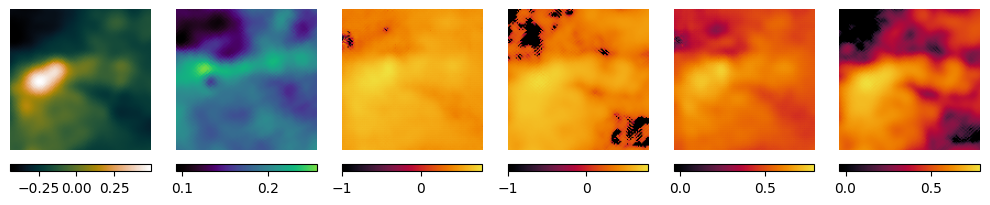

...

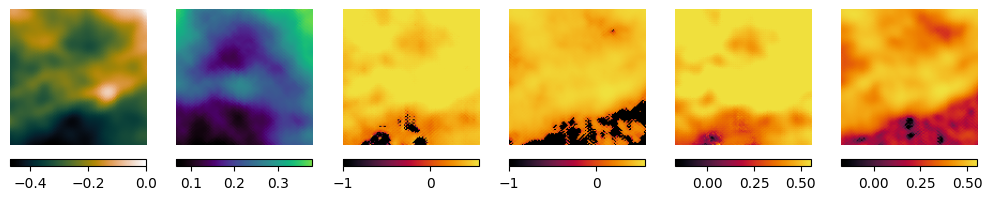

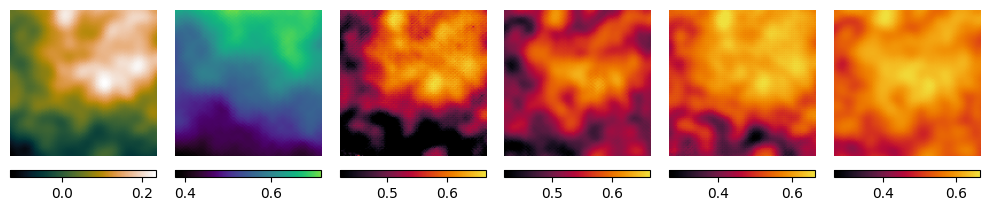

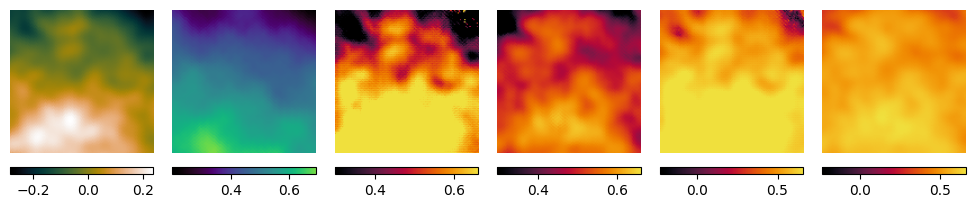

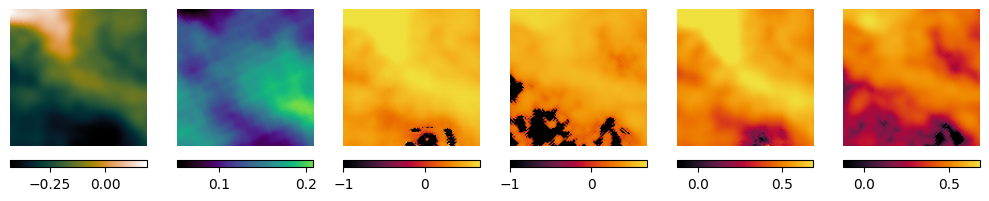

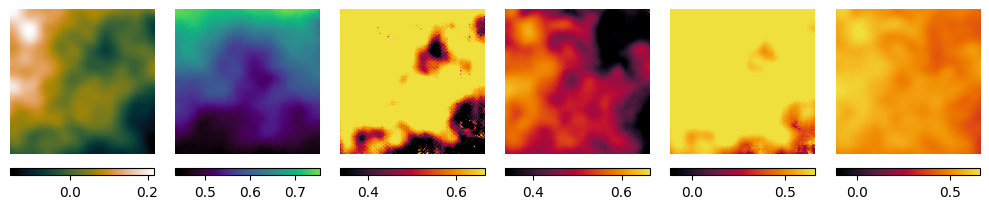

In [59]:
# 2. Run Inference
# Use no_grad to save memory and computations

tens_out= [] 
c=0 
with torch.no_grad():
    long_idx=0
    for i, batch in enumerate(dataloader):
        real_A = batch['A'].to(device)
        
        # Generate Fake B
        fake_B_tensor = G_AB(real_A)
        
        # Move to CPU and Numpy
        # .detach() is required to remove it from the computation graph
        real_A_np = real_A.cpu().detach().numpy()
        
        fake_B_np = fake_B_tensor.cpu().detach().numpy()
        tens_out.append(fake_B_np) 
        real_B_np = batch['B'].numpy() # This is likely random B, not paired B (CycleGAN nature)
        # Stop after one batch for plotting
        if i<=2: 
        

            for idx in range(real_A_np.shape[0] ) : 
            
                fig, axes = plt.subplots(1, 6, figsize=(10, 4))
                # Standard "Magic Numbers" to make colorbar match image height
                cbar_kwargs = {'fraction': 0.046, 'pad': 0.04,'orientation':'horizontal'}
                # --- Channel 0 (e.g., Density/Flux) ---
                # Input A
                im1 = axes[0].imshow(real_A_np[idx, 0, :, :], cmap=cm.savanna, origin='lower') 
                if long_idx==0: axes[0].set_title("Thermal Dust ", fontsize=12 )
                plt.colorbar(im1, ax=axes[ 0],**cbar_kwargs)
                axes[0].axis('off')
                # Generated B
                im2 = axes[ 2].imshow(fake_B_np[idx, 0, :, :], vmin=real_B_np[idx, 1, :, :].min(),vmax=real_B_np[idx, 1, :, :].max(), cmap=cm.ember, origin='lower')
                if long_idx==0: axes[ 2].set_title("CO J:1-0 - mock ", fontsize=12 )
                plt.colorbar(im2, ax=axes[2],**cbar_kwargs)
                axes[2].axis('off')
                
                # Real B (Random Sample from Domain B)
                im3 = axes[ 3].imshow(real_B_np[idx, 0, :, :],vmin=real_B_np[idx, 1, :, :].min(),vmax=real_B_np[idx, 1, :, :].max(),  cmap=cm.ember, origin='lower')
                #im3 = axes[0, 2].imshow(real_B_np[idx, 0, :, :]-fake_B_np[idx, 0, :, :], cmap='magma', origin='lower')
                
                if long_idx==0: axes[3].set_title("CO J:1-0 - real ", fontsize=12 )
                plt.colorbar(im3, ax=axes[ 3],**cbar_kwargs)
                axes[3].axis('off')
                
                # --- Channel 1 (e.g., Velocity/Temperature) ---
                # Input A
                im4 = axes[ 1].imshow(real_A_np[idx, 1, :, :], cmap=cm.lavender, origin='lower')
                if long_idx==0: axes[1].set_title(" N(HI) ", fontsize=12 )
                plt.colorbar(im4, ax=axes[1],**cbar_kwargs) 
                axes[1].axis('off')
                
                # Generated B
                im5 = axes[4].imshow(fake_B_np[idx, 1, :, :],vmin=fake_B_np[idx, 1, :, :].min(), vmax=real_B_np[idx, 1, :, :].max() ,cmap=cm.ember, origin='lower')
                if long_idx==0: axes[4].set_title("CO J:2-1 - mock", fontsize=12 )
                plt.colorbar(im5, ax=axes[4],**cbar_kwargs)
                axes[4].axis('off')
                
                # Real B
                im6 = axes[5].imshow(real_B_np[idx, 1, :, :],vmin=fake_B_np[idx, 1, :, :].min(), vmax=real_B_np[idx, 1, :, :].max() , cmap=cm.ember, origin='lower')
                #im6 = axes[1, 2].imshow(real_B_np[idx, 1, :, :]-fake_B_np[idx, 1, :, :], cmap='magma', origin='lower')
                axes[5].axis('off')
                
                if long_idx==0: axes[5] .set_title("CO J:2-1 - real", fontsize=12 )
                plt.colorbar(im6, ax=axes[5],**cbar_kwargs)
                
                plt.tight_layout()
                #if idx>4 : break 
                #plt.savefig(f'{workdir}/figures/generated_AB_{long_idx}.pdf')
                long_idx+=1 

            
            
            #if idx>4 : break
# np.concatenate joins the batches along the first axis (batch dimension)
# Result shape will be (Total_Samples, 2, 128, 128)
tens_set = np.concatenate(tens_out, axis=0)
test_set= tens_set.reshape((tens_set.shape[0] , tens_set.shape[2], tens_set.shape[3], tens_set.shape[1]) ) 
output_file =f'{workdir}/unpaired_training_norm/predictions/CO_cyclegan1_predictions_normalized.npz' 

np.savez(    output_file,  ypred=test_set  )  
# 3. Plotting Logic (for 2-Channel Data)
# We will plot the first image in the batch (index 0)


## testing G_BA 

In [32]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

import glob 
import re
chks = (glob . glob (f"{workdir}/unpaired_training_norm/checkpoint_epoch_*" )) 
    # Regex to extract the epoch number
def extract_epoch(filename):
    match = re.search(r"checkpoint_epoch_(\d+).pth", filename)
    return int(match.group(1)) if match else -1
    # Sort based on epoch number (Descending)

latest_chkp  = max(chks, key=extract_epoch)
#latest_chkp=f"{workdir}/unpaired_training_norm/checkpoint_epoch_720.pth"
# Usage:
G_BA = load_for_inference(latest_chkp, generator='G_BA' )
G_BA.eval()
print(latest_chkp) 

Generator loaded successfully for inference.
/pscratch/sd/g/giuspugl/workstation/CO_network//unpaired_training_norm/checkpoint_epoch_800.pth


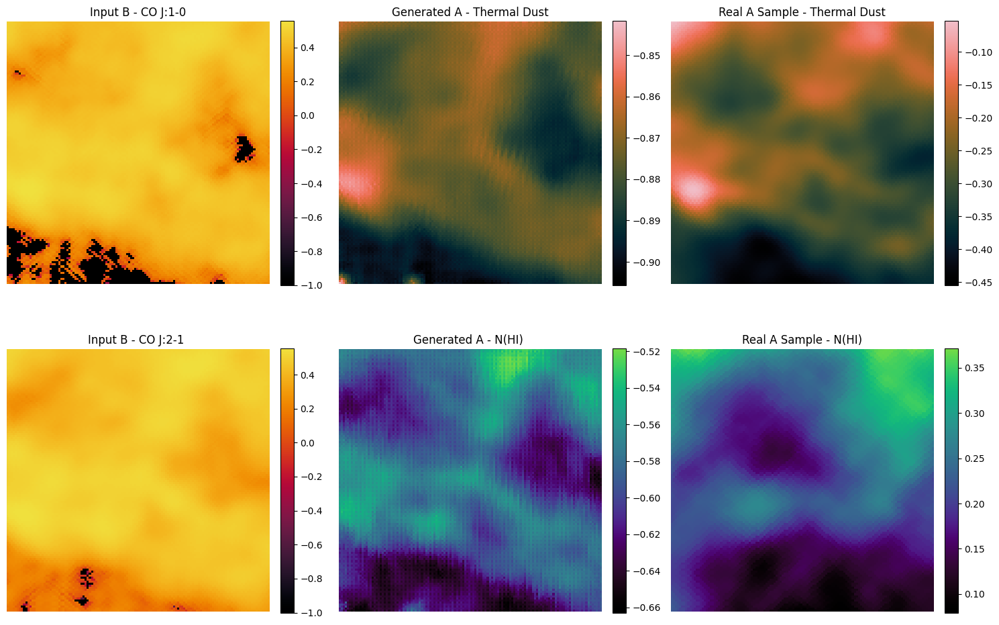

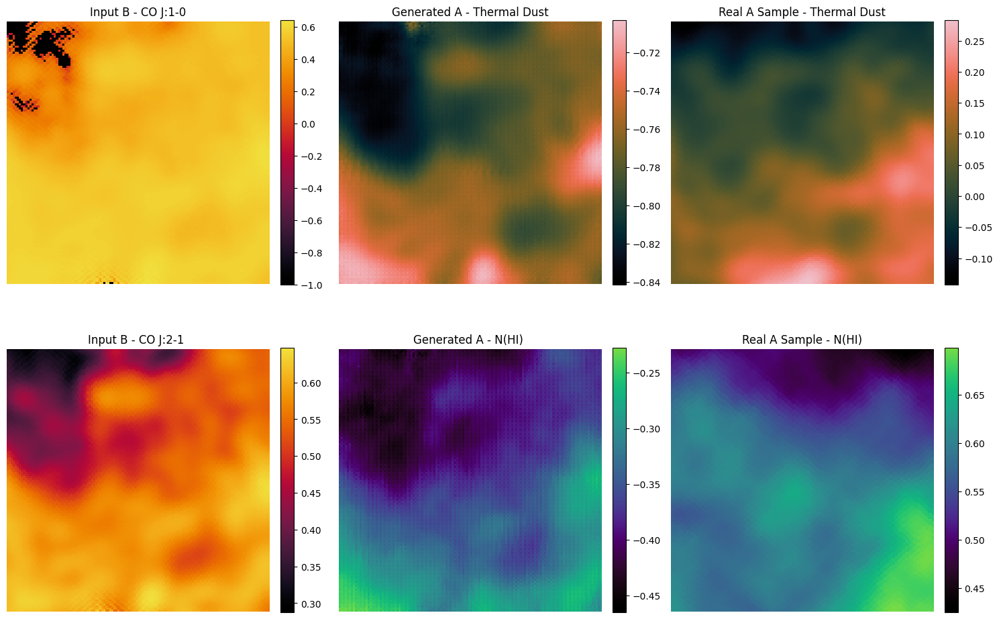

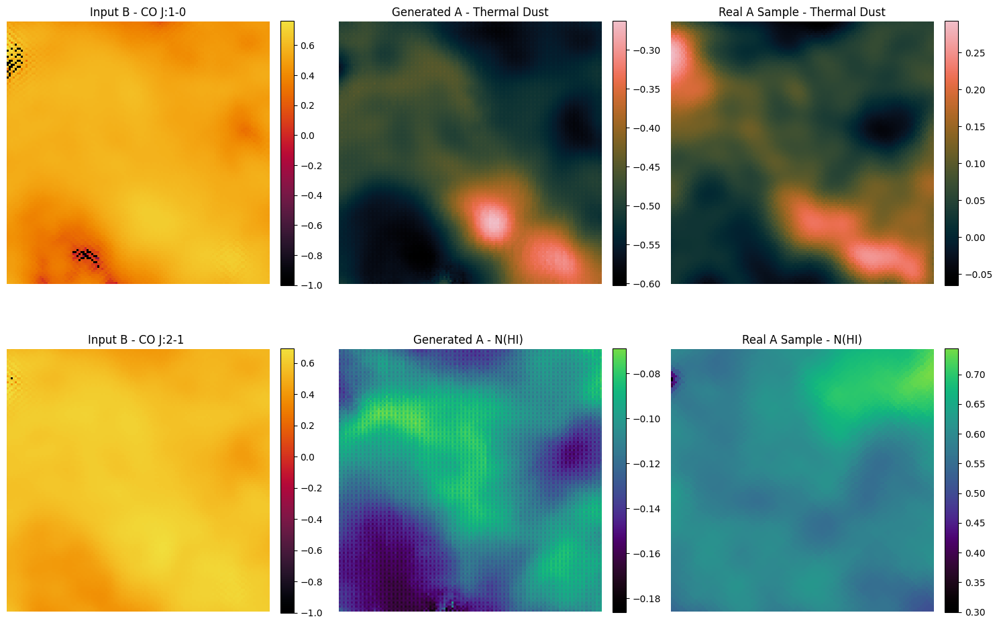

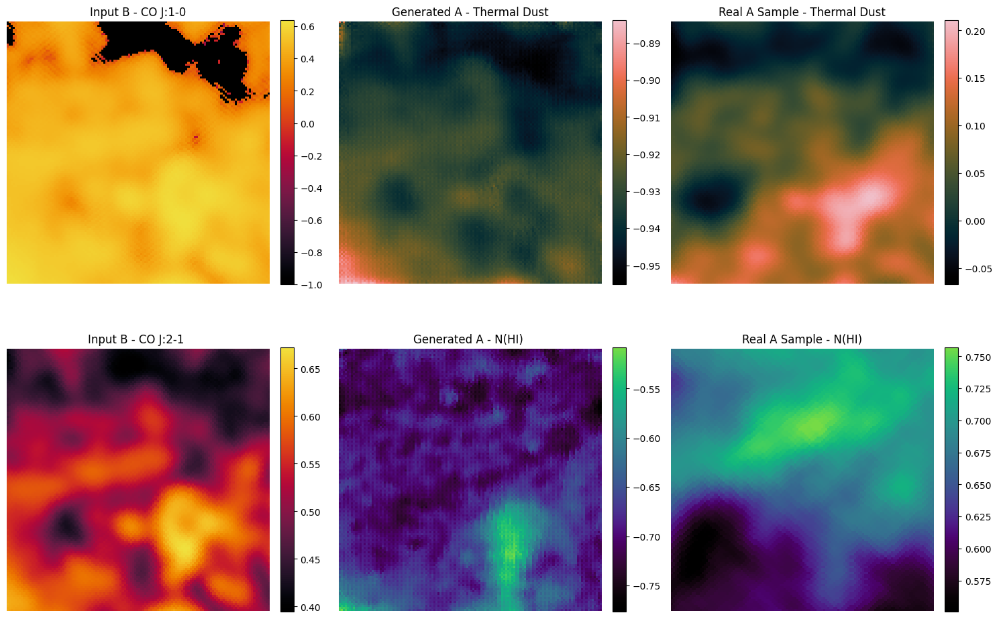

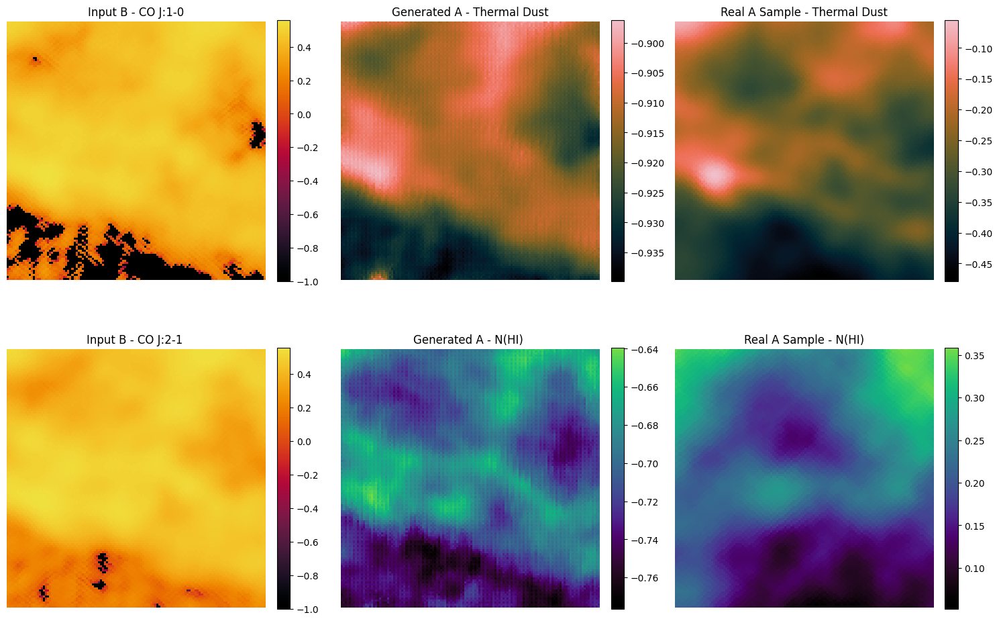

...

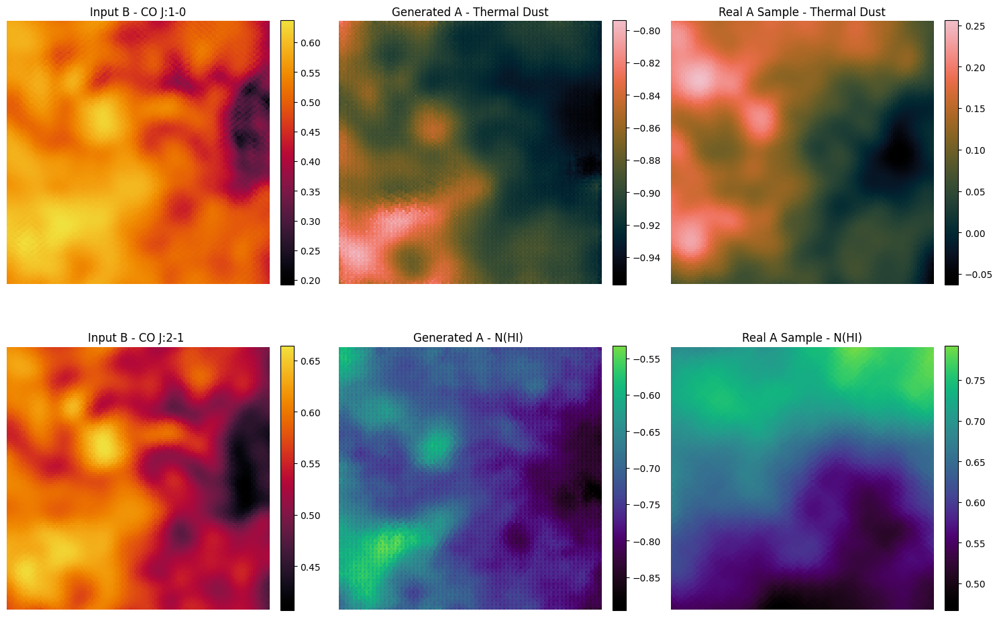

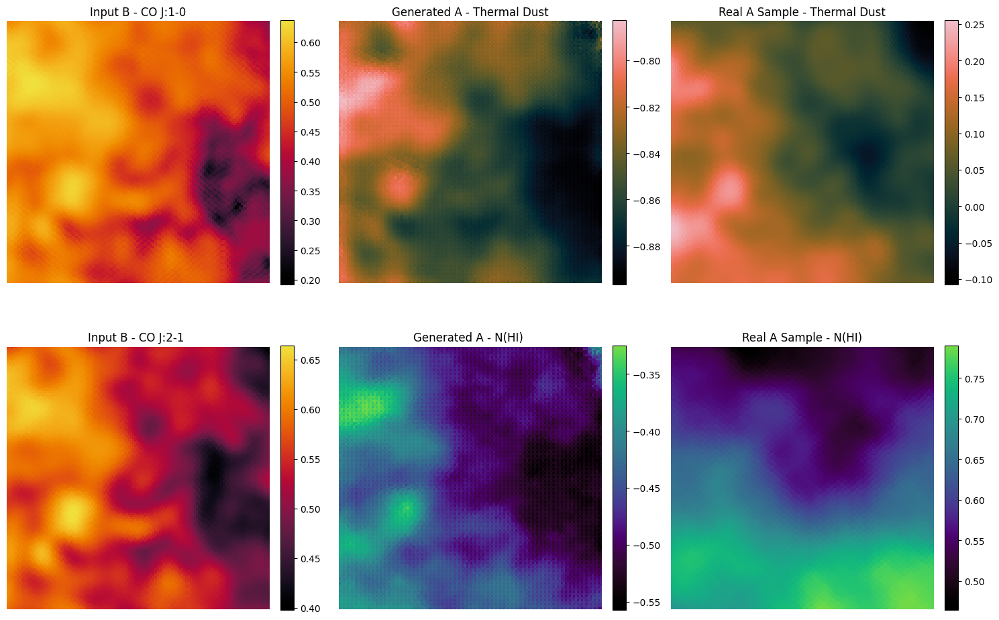

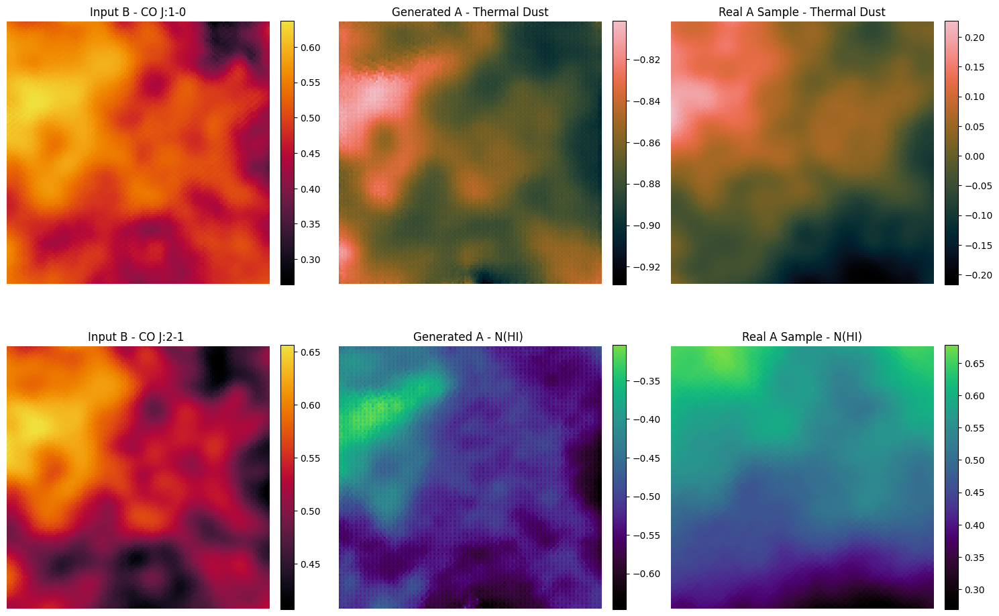

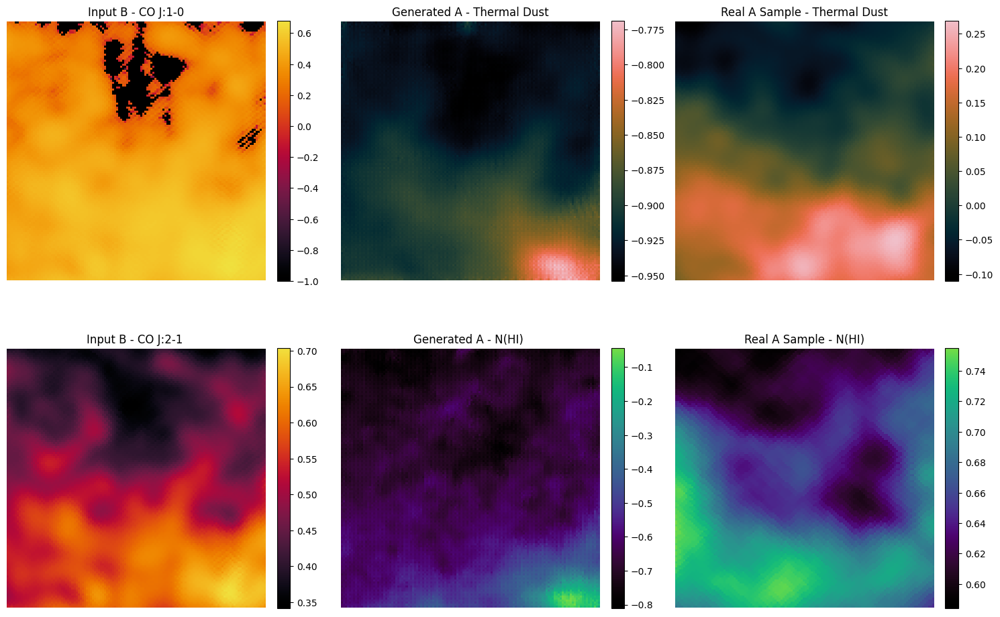

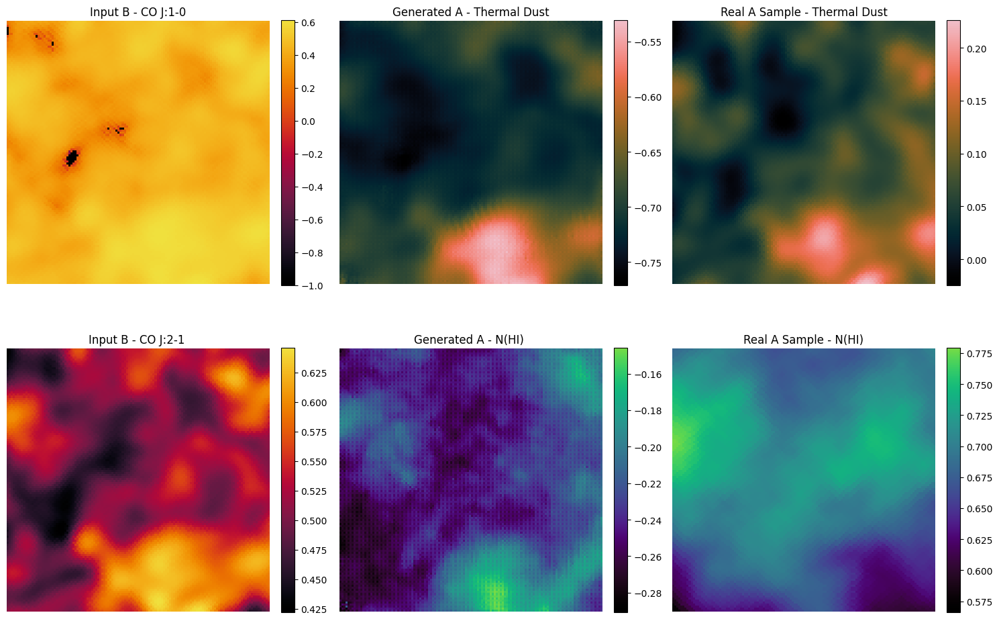

In [33]:
# 2. Run Inference
# Use no_grad to save memory and computations


with torch.no_grad():
    long_idx =0 
    for i, batch in enumerate(dataloader):

        ### /!\ carefull that i am switching variables here ! 
        real_A = batch['B'].to(device)
        
        # Generate Fake B
        fake_B_tensor = G_BA(real_A)
        
        # Move to CPU and Numpy
        # .detach() is required to remove it from the computation graph
        real_A_np = real_A.cpu().detach().numpy()
        fake_B_np = fake_B_tensor.cpu().detach().numpy()
        real_B_np = batch['A'].numpy() # This is likely random B, not paired B (CycleGAN nature)
        
        # Stop after one batch for plotting
        if i>2: break 
        
    
        
        
        # 3. Plotting Logic (for 2-Channel Data)
        # We will plot the first image in the batch (index 0)
        for idx in range(real_A_np.shape[0]) : 
        
            fig, axes = plt.subplots(2, 3, figsize=(15, 10))
            
            # --- Channel 0 (e.g., Density/Flux) ---
            # Input A
            im1 = axes[0, 0].imshow(real_A_np[idx, 0, :, :], cmap=cm.ember, origin='lower')
            axes[0, 0].set_title("Input B - CO J:1-0")
            axes[0,0].axis('off')
            cbar_kwargs = {'fraction': 0.046, 'pad': 0.04}
            plt.colorbar(im1, ax=axes[0, 0],**cbar_kwargs)
            
            # Generated B
            im2 = axes[0, 1].imshow(fake_B_np[idx, 0, :, :], cmap=cm.dusk , origin='lower')
            axes[0, 1].set_title("Generated A - Thermal Dust")
            axes[0,1].axis('off')
            
            cbar_kwargs = {'fraction': 0.046, 'pad': 0.04}
            plt.colorbar(im2, ax=axes[0, 1],**cbar_kwargs)
            
            # Real B (Random Sample from Domain B)
            im3 = axes[0, 2].imshow(real_B_np[idx, 0, :, :], cmap=cm.dusk, origin='lower')
            axes[0, 2].set_title("Real A Sample - Thermal Dust")
            cbar_kwargs = {'fraction': 0.046, 'pad': 0.04}
            plt.colorbar(im3, ax=axes[0, 2],**cbar_kwargs)
            axes[0,2].axis('off')
            
            # --- Channel 1 (e.g., Velocity/Temperature) ---
            # Input A
            im4 = axes[1, 0].imshow(real_A_np[idx, 1, :, :], cmap=cm.ember, origin='lower')
            axes[1, 0].set_title("Input B - CO J:2-1 ")
            cbar_kwargs = {'fraction': 0.046, 'pad': 0.04}
            plt.colorbar(im4, ax=axes[1, 0],**cbar_kwargs)
            axes[1,0].axis('off')
            
            # Generated B
            im5 = axes[1, 1].imshow(fake_B_np[idx, 1, :, :], cmap=cm.lavender, origin='lower')
            axes[1, 1].set_title("Generated A - N(HI) ")
            cbar_kwargs = {'fraction': 0.046, 'pad': 0.04}
            plt.colorbar(im5, ax=axes[1, 1],**cbar_kwargs)
            axes[1,1].axis('off')
            
            # Real B
            im6 = axes[1, 2].imshow(real_B_np[idx, 1, :, :], cmap=cm.lavender, origin='lower')
            axes[1, 2].set_title("Real A Sample - N(HI)")
            axes[1,2].axis('off')
            
            cbar_kwargs = {'fraction': 0.046, 'pad': 0.04}
            plt.colorbar(im6, ax=axes[1, 2],**cbar_kwargs)
            
            plt.tight_layout()
            plt.savefig(f'{workdir}/generated_BA_{long_idx}.pdf') 
            long_idx+=1

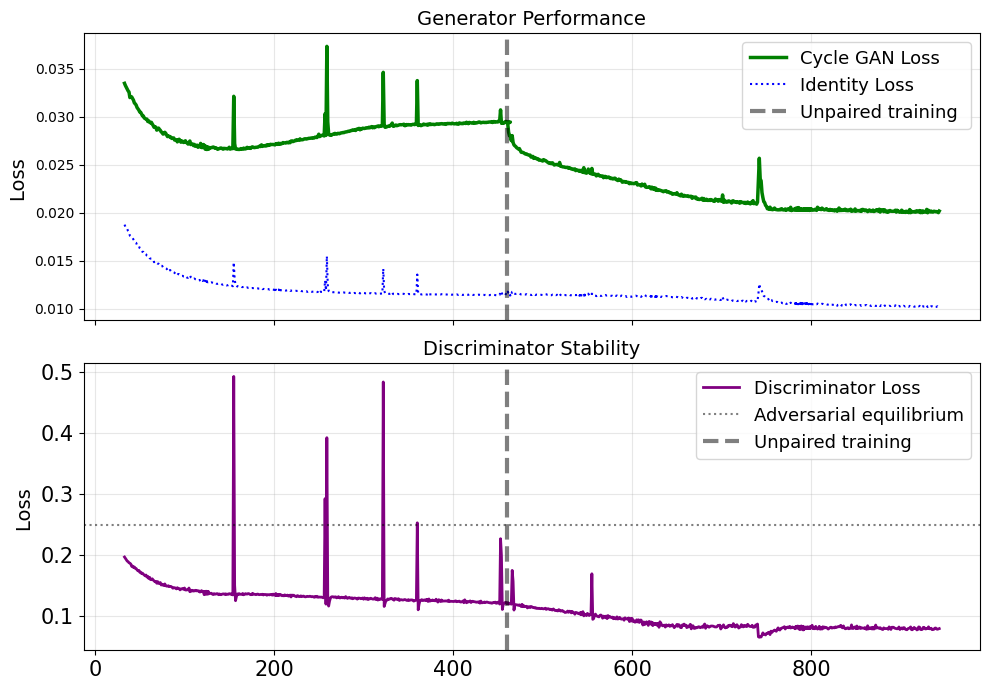

In [76]:

def running_mean(x, N):
    cumsum = np.cumsum(np.insert(x, 0, 0)) 
    return (cumsum[N:] - cumsum[:-N]) / float(N)


import pandas as pd
import matplotlib.pyplot as plt

def plot_training_logs(csv_file_path):
    # Load Data
    try:
        df = pd.read_csv(csv_file_path)
    except FileNotFoundError:
        print(f"Error: File not found at {csv_file_path}")
        return

    # Create Subplots
    fig, axes = plt.subplots(2, 1, figsize=(10, 7), sharex=True)

    # ---------------------------------
    # Plot 1: Generator Loss Breakdown
    # ---------------------------------
    ax1 = axes[0]
    # Total Loss (Faded, just for context)
    #ax1.plot(df['Epoch'], df['Loss_G'], label='Total G Loss', color='gray', alpha=0.4, linewidth=1)
    
    # The Critical Component: Cycle Loss
    ax1.plot(df['Epoch'], df['Loss_G_Cycle'], label='Cycle GAN Loss ', color='green', linewidth=2.5)
    
    # The Stability Component: GAN Loss
    #ax1.plot(df['Epoch'], df['Loss_G_GAN'], label='GAN Loss (Should Oscillate)', color='red', linestyle='--', linewidth=1.5)
    
    # Identity Loss
    if 'Loss_G_ID' in df.columns:
        ax1.plot(df['Epoch'], df['Loss_G_ID'], label='Identity Loss', color='blue', linestyle=':', linewidth=1.5)
    ax1.axvline(x=460, color='black', linestyle='--',linewidth=3,  alpha=0.5, label='Unpaired training ')

    ax1.set_title("Generator Performance", fontsize=14, )
    ax1.set_ylabel("Loss ", fontsize=14)
    ax1.legend(loc='upper right', fontsize=13)
    ax1.grid(True, alpha=0.3)
    plt.yticks(fontsize=15) 
    plt.xticks(fontsize=15) 
    # ---------------------------------
    # Plot 2: Discriminator Stability
    # ---------------------------------
    ax2 = axes[1]
    ax2.plot(df['Epoch'], df['Loss_D'], label='Discriminator Loss', color='purple', linewidth=2)
    
    # Add Ideal Reference Line for LSGAN (0.25)
    ax2.axhline(y=0.25, color='black', linestyle=':', alpha=0.5, label='Adversarial equilibrium')
    ax2.axvline(x=460, color='black', linestyle='--',linewidth=3,  alpha=0.5, label='Unpaired training ')
    #plt.yticks(fontsize=15) 
    #plt.xticks(fontsize=15) 
    ax2.set_title("Discriminator Stability", fontsize=14 )
    ax2.set_ylabel("Loss ", fontsize=14)
    ax2.legend(loc='upper right', fontsize=13)
    ax2.grid(True, alpha=0.3)

    # ---------------------------------
    # Plot 3: Physics Diagnostics
    # ---------------------------------
    """
    ax3 = axes[2]
    
    # Plot PSD Error on Left Axis
    line1 = ax3.plot(df['Epoch'], df['PSD_Error'], label='PSD Error (Structure)', color='orange', linewidth=2)
    ax3.set_ylabel("PSD Error (Log Scale)", color='orange', fontweight='bold')
    ax3.tick_params(axis='y', labelcolor='orange')
    
    # Plot Histogram Error on Right Axis (Different Scale)
    ax3_right = ax3.twinx()
    line2 = ax3_right.plot(df['Epoch'], df['Hist_Error'], label='Histogram Error (Flux)', color='teal', linestyle='--', linewidth=2)
    ax3_right.set_ylabel("Histogram MSE", color='teal', fontweight='bold')
    ax3_right.tick_params(axis='y', labelcolor='teal')

    # Combine legends
    lines = line1 + line2
    labels = [l.get_label() for l in lines]
    ax3.legend(lines, labels, loc='upper right')

    ax3.set_title("", fontsize=14, fontweight='bold')
    ax3.set_xlabel("Epoch", fontsize=12)
    ax3.grid(True, alpha=0.3)
    """
    plt.tight_layout()
    plt.savefig(f'{workdir}/loss_behavior.pdf')
    #plt.show()

# Usage
# Change this path to your actual CSV location\
#log_file =f"{workdir}/unpaired_training_norm/training_log-Copy1.csv" 
log_file =f"{workdir}/extending_CO/new_experiment/training_log.csv" 
plot_training_logs(log_file)

In [15]:
print()

### Comparison with Puglisi 

In [63]:

dust = np.load(f'{workdir}/data/lognormalized_dust_fullsky.npz')['patches']
lon  = np.load(f'{workdir}/data/lognormalized_dust_fullsky.npz')['lon']
lat  = np.load(f'{workdir}/data/lognormalized_dust_fullsky.npz')['lat']
nh = np.load(f'{workdir}/data/lognormalized_nhi_fullsky.npz')['patches'] 
mask =np.logical_and(lon<242 , lon>238) 
Xin   = np.float32(np.stack([dust[mask],nh[mask]  ], axis=1 ) ) 
print(Xin.shape) 
# 3. Save to .pt file
tensor_data = torch.from_numpy(Xin ).float() # .float() is usually safer for NN training

torch.save(tensor_data, f"{workdir}/data/fileA_lon240.pt")
Xin   = np.float32(np.stack([dust,nh  ], axis=1 ) ) 
print(Xin.shape) 
# 3. Save to .pt file
tensor_data = torch.from_numpy(Xin ).float() # .float() is usually safer for NN training

torch.save(tensor_data, f"{workdir}/data/fileA_fullsky.pt")


(63, 2, 128, 128)
(8452, 2, 128, 128)


In [65]:
co10data = np.load(f'{workdir}/data/lognormalized_co1_fullsky.npz')['patches']
co21data = np.load(f'{workdir}/data/lognormalized_co2_fullsky.npz')['patches']
co21 = np.load(f'{workdir}/data/co21_pysm_15amin_T.npz')['patches']
co10 = np.load(f'{workdir}/data/co10_pysm_15amin_T.npz')['patches']
Xout   = np.float32(np.stack([co10[mask],co21[mask]  ], axis=1 ) ) 
tensor_data = torch.from_numpy(Xout ).float() # .float() is usually safer for NN training
torch.save(tensor_data, f"{workdir}/data/fileB_lon240.pt")

Xout   = np.float32(np.stack([co10,co21  ], axis=1 ) ) 
tensor_data = torch.from_numpy(Xout ).float() # .float() is usually safer for NN training
torch.save(tensor_data, f"{workdir}/data/fileB_fullsky.pt")

In [60]:
fileA= f'{workdir}/data/fileA_fullsky.pt'
fileB= f'{workdir}/data/fileB_fullsky.pt'
dataloader_full = get_memory_loader(fileA, fileB ,mode='paired',  batch_size=4) 


Loading tensors...


In [25]:
test_set.shape

(63, 128, 128, 2)

In [26]:
# 2. Run Inference
# Use no_grad to save memory and computations

tens_out= [] 
with torch.no_grad():
    long_idx =0 
    for i, batch in enumerate(dataloader_full):
        real_A = batch['A'].to(device)
        
        # Generate Fake B
        fake_B_tensor = G_AB(real_A)
        
        # Move to CPU and Numpy
        # .detach() is required to remove it from the computation graph
        real_A_np = real_A.cpu().detach().numpy()
        fake_B_np = fake_B_tensor.cpu().detach().numpy()
        tens_out.append(fake_B_np) 
        real_B_np = batch['B'].numpy() # This is likely random B, not paired B (CycleGAN nature)
        # Stop after one batch for plotting
        #if i>2: break 
# np.concatenate joins the batches along the first axis (batch dimension)
# Result shape will be (Total_Samples, 2, 128, 128)
tens_set = np.concatenate(tens_out, axis=0)
test_set= tens_set.reshape((tens_set.shape[0] , tens_set.shape[2], tens_set.shape[3], tens_set.shape[1]) ) 
output_file =f'{workdir}/CO_cyclegan1_fullsky_predictions.npz' 

print(test_set.shape)
np.savez(    output_file,  ypred=test_set    ) 


(8452, 128, 128, 2)


In [39]:
import healpy as hp 
dic_maps ={ 
'co1': hp.read_map(f'{workdir}/data/CO10type2_15amin_nside2048.fits') ,
'co2': hp.read_map(f'{workdir}/data/CO21type2_15amin_nside2048.fits')  }
test_set_phys=np.empty_like(test_set) 
for ii, k    in enumerate(['co1', 'co2']) : 
    print(k) 
    m= dic_maps[k]

    norm = AstroNormalization(m.min(),m.max() ) 
    test_set_phys[:,:,:, ii]   = norm.denormalize(test_set[:,:,:, ii]     )
    print( test_set_phys[:,:,:, ii].min(),test_set_phys[:,:,:, ii].max()  ) 
       
output_file =f'{workdir}/data/CO_cyclegan1_fullsky_predictions_physical.npz' 
np.savez(    output_file,  ypred=test_set_phys    ) 


co1
shifting min to neg value
-225.4627 2485.301
co2
shifting min to neg value
-34.983425 838.7659


In [66]:
# 2. Run Inference
# Use no_grad to save memory and computations
fileA= f'{workdir}/data/fileA_lon240.pt'
fileB= f'{workdir}/data/fileB_lon240.pt'
dataloader_full = get_memory_loader(fileA, fileB ,mode='paired', shuffle=False,  batch_size=4) 

Loading tensors...


0
1
2
3
4
5


/tmp/ipykernel_1984020/381104596.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 8, figsize=(13, 2))


6
7
8
9
10
11
12
13
14
15


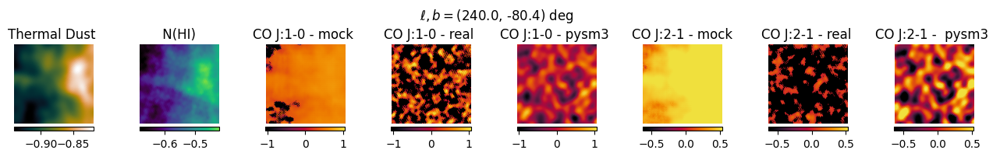

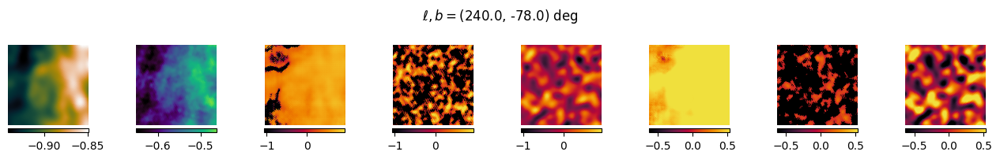

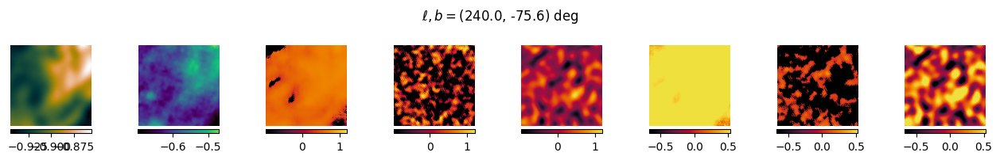

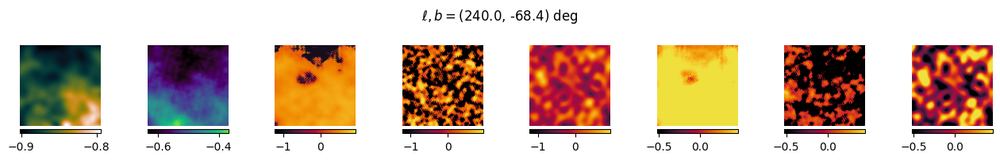

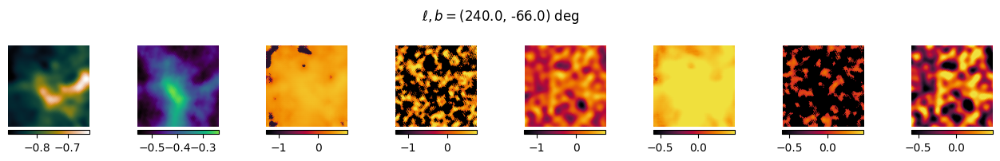

...

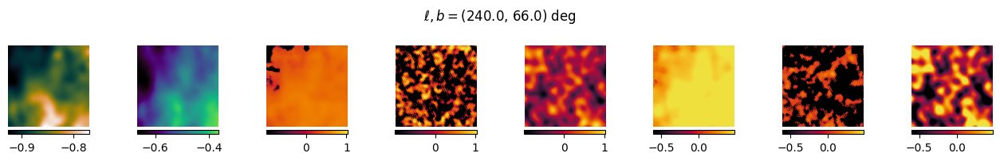

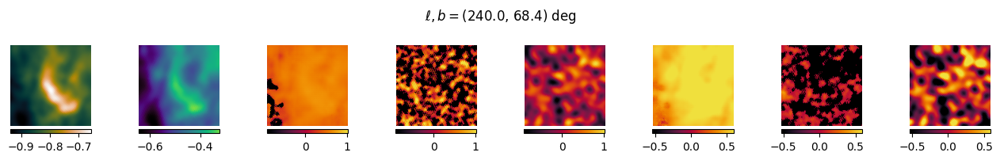

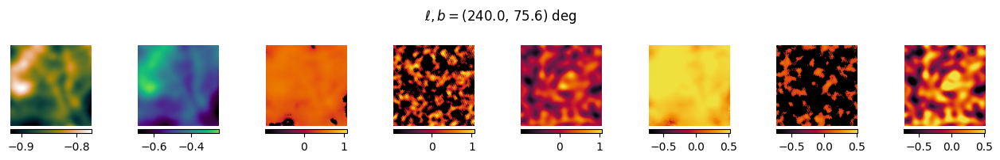

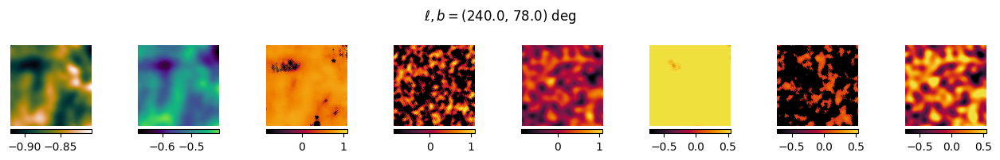

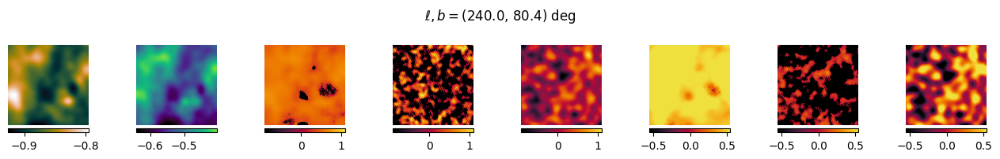

In [67]:


tens_out= [] 
with torch.no_grad():
    long_idx =0 
    for i, batch in enumerate(dataloader_full):
        print(i) 
        real_A = batch['A'].to(device)
        
        # Generate Fake B
        fake_B_tensor = G_AB(real_A)
        
        # Move to CPU and Numpy
        # .detach() is required to remove it from the computation graph
        real_A_np = real_A.cpu().detach().numpy()
        fake_B_np = fake_B_tensor.cpu().detach().numpy()
        tens_out.append(fake_B_np) 
        real_B_np = batch['B'].numpy() # This is likely random B, not paired B (CycleGAN nature)
        #plot just the first sample of the batch
        
        for idx in range(real_A_np.shape[0] ) : 
        
            fig, axes = plt.subplots(1, 8, figsize=(13, 2))
            plt.suptitle(r'$\ell, b =$'+f'({lon[mask][long_idx]:.1f}, {lat[mask][long_idx]:.1f}) deg')
            # Standard "Magic Numbers" to make colorbar match image height
            cbar_kwargs = {'fraction': 0.046, 'pad': 0.04,'orientation':'horizontal'}
            # --- Channel 0 (e.g., Density/Flux) ---
            # Input A
            im1 = axes[0].imshow(real_A_np[idx, 0, :, :], cmap=cm.savanna, origin='lower')
            if long_idx==0: axes[0].set_title("Thermal Dust ", fontsize=12 )
            plt.colorbar(im1, ax=axes[ 0],**cbar_kwargs)
            axes[0].axis('off')
            # Generated B
            im2 = axes[ 2].imshow(fake_B_np[idx, 0, :, :], vmin=real_B_np[idx, 0, :, :].min(),vmax=real_B_np[idx, 0, :, :].max(), cmap=cm.ember, origin='lower')
            if long_idx==0: axes[ 2].set_title("CO J:1-0 - mock ", fontsize=12 )
            plt.colorbar(im2, ax=axes[2],**cbar_kwargs)
            axes[2].axis('off')
            im10= axes[ 3].imshow(co10data[mask][idx,  :, :],vmin=real_B_np[idx, 0, :, :].min(),vmax=real_B_np[idx, 0, :, :].max(),  cmap=cm.ember, origin='lower')
            # Real B (Random Sample from Domain B)
            im3 = axes[ 4].imshow(real_B_np[idx, 0, :, :],vmin=real_B_np[idx, 0, :, :].min(),vmax=real_B_np[idx, 0, :, :].max(),  cmap=cm.ember, origin='lower')
            #im3 = axes[0, 2].imshow(real_B_np[idx, 0, :, :]-fake_B_np[idx, 0, :, :], cmap='magma', origin='lower')
            
            if long_idx==0: 
                axes[3].set_title("CO J:1-0 - real ", fontsize=12 )
                axes[4].set_title("CO J:1-0 - pysm3 ", fontsize=12 )
            plt.colorbar(im3, ax=axes[ 4],**cbar_kwargs)
            plt.colorbar(im10, ax=axes[ 3],**cbar_kwargs)
            axes[3].axis('off')
            axes[4].axis('off')
            
            # --- Channel 1 (e.g., Velocity/Temperature) ---
            # Input A
            im4 = axes[ 1].imshow(real_A_np[idx, 1, :, :], cmap=cm.lavender, origin='lower')
            if long_idx==0: axes[1].set_title(" N(HI) ", fontsize=12 )
            plt.colorbar(im4, ax=axes[1],**cbar_kwargs) 
            axes[1].axis('off')
            
            # Generated B
            im5 = axes[5].imshow(fake_B_np[idx, 1, :, :],vmin=real_B_np[idx, 1, :, :].min(), vmax=real_B_np[idx, 1, :, :].max() ,cmap=cm.ember, origin='lower')
            if long_idx==0: axes[5].set_title("CO J:2-1 - mock", fontsize=12 )
            plt.colorbar(im5, ax=axes[5],**cbar_kwargs)
            axes[5].axis('off')
            
            im21= axes[ 6].imshow(co21data[mask][idx,  :, :],vmin=real_B_np[idx, 1, :, :].min(),vmax=real_B_np[idx, 1, :, :].max(),  cmap=cm.ember, origin='lower')
            # Real B (Random Sample from Domain B)
            im6 = axes[ 7].imshow(real_B_np[idx, 0, :, :],vmin=real_B_np[idx, 1, :, :].min(),vmax=real_B_np[idx, 1, :, :].max(),  cmap=cm.ember, origin='lower')
            #im3 = axes[0, 2].imshow(real_B_np[idx, 0, :, :]-fake_B_np[idx, 0, :, :], cmap='magma', origin='lower')
            
            if long_idx==0: 
                axes[6].set_title("CO J:2-1 - real ", fontsize=12 )
                axes[7].set_title("CO J:2-1 -  pysm3 ", fontsize=12 )
            plt.colorbar(im6, ax=axes[ 6],**cbar_kwargs)
            plt.colorbar(im21, ax=axes[ 7],**cbar_kwargs)
            axes[6].axis('off')
            axes[7].axis('off')
            
            plt.tight_layout()
            #if idx>4 : break 
            plt.savefig(f'{workdir}/figures/comparison_{long_idx}.pdf')
            long_idx+=1 

        #if long_idx>15:break 

In [8]:
import numpy as np 
import healpy as hp 

import numpy as np
import torch 
class AstroNormalization:
    def __init__(self, global_min, global_max):
        """
        Args:
            global_min (float): The minimum value in your ENTIRE dataset (e.g., 0)
            global_max (float): The maximum value in your ENTIRE dataset.
        """
        self.min = global_min
        self.max = global_max
        self.epsilon = 1e-6 # To avoid log(0)
    

        
    def normalize(self, x):
        """
        Input: Raw physical units  
        Output: Tensor in range [-1, 1]
        """
        xp =x.copy() 
        
        xp[x<=self.epsilon]  = self.epsilon
        xp[x>self.epsilon] = x[x>self.epsilon ] +self.epsilon 
        #if self.min<0: 
        #    print(f"maps has neg values {self.min } , shifting min to 0"   ) 
            
        #    xp = x -self.min  
        #else : 
        #    xp =x.copy() 
        # 1. Log Transform (Compress range)
         
        x_log = np.log10(xp)
        
 
        log_min = x_log.min() 
        log_max = x_log.max() 
        print(self.min, self.max, log_min, log_max) 
        # 2. global  MinMax to [-1, 1]  
        x_norm = 2 * (x_log - log_min) / (log_max - log_min) - 1
        
        return x_norm  

    def denormalize(self, x_norm):
        """
        Input: Tensor in range [-1, 1] (Output of Generator)
        Output: Physical units
        """
        if self.min<0:
            log_min = np.log10(self.epsilon)
        else :
            log_min = np.log10(self.min + self.epsilon)
        log_max = np.log10(self.max + self.epsilon)
        # 1. Inverse MinMax
        x_log = (x_norm + 1) / 2 * (log_max - log_min) + log_min
        
        # 2. Inverse Log
        x_phys = np.pow(10, x_log) -self.epsilon 
        if self.min<0: 
            msk = x_phys<=self.epsilon
            x_phys[msk] =self.min  
        return x_phys

    

In [9]:
from scipy import stats 
import healpy as hp 

workdir ="/pscratch/sd/g/giuspugl/workstation/CO_network/"

dic_maps ={
'co1': hp.read_map(f'{workdir}/data/CO10type2_15amin_nside2048.fits') ,
'co2': hp.read_map(f'{workdir}/data/CO21type2_15amin_nside2048.fits')  }

cotset = {
    'co1':pl.load(f"{workdir}/data/lognormalized_co1_test.npz")['patches'], 
    'co2':pl.load(f"{workdir}/data/lognormalized_co2_test.npz")['patches'] } 
    
copt  ={ 
    'co1':pl.load(f"{workdir}//unpaired_training_norm/predictions/CO_cyclegan1_predictions_normalized.npz") ['ypred'][:,:,:,0], 
    'co2':pl.load(f"{workdir}//unpaired_training_norm/predictions/CO_cyclegan1_predictions_normalized.npz") ['ypred'][:,:,:,1] } 


In [5]:
from scipy import stats 
import healpy as hp 

0.16976268946757744


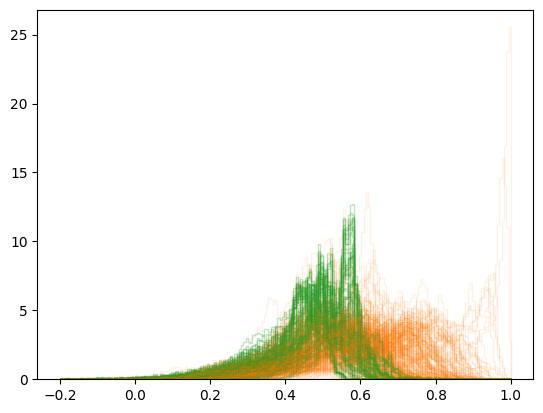

In [56]:

alpha=.05
n=cotset['co1'].shape[2] 
threshold =  np.sqrt(-np.log(alpha/2)/n ) 
print(threshold) 
ksvals ={} 
for k,m in dic_maps.items() : 

    norm = AstroNormalization(m.min(), m.max() ) 
    test=norm.denormalize (cotset[k]) 
    pred= norm.denormalize (copt[k] ) 
    test=cotset[k]
    pred=copt[k]
    #ks,pval =  stats.ks_2samp(test.flatten() ,pred.flatten() ) 
    #ksvals[k]=[] 
    
    for ii in range(copt['co1'].shape[0]):
        pl.hist(test[ii].flatten() ,bins=np.linspace(-.2,1,200) , density=True
                , histtype='step',color='C2', alpha=.1 )
        pl.hist(pred[ii].flatten(),bins=np.linspace(-.2,1,200), density=True
                , histtype='step' , color='C1' , alpha=.1)
    
    break 

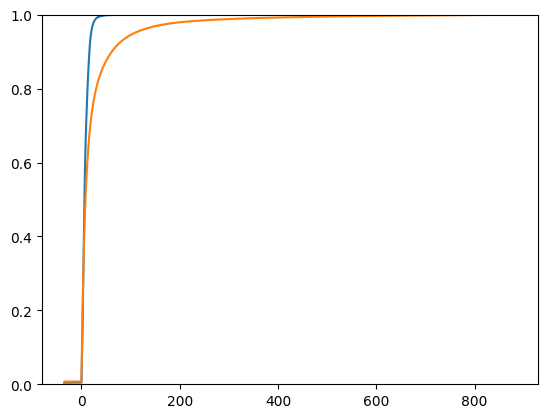

In [35]:
mask = test>0 
pl.ecdf(test .flatten() ) 
pl.ecdf(pred.flatten() ) 
#pl.semilogx() 
ks,pval =  stats.ks_2samp(cotset[k].flatten() ,copt[k] .flatten() ) 
 

In [24]:
print(ks,threshold , pval) 

0.23316701253255212 0.16976268946757744 0.0


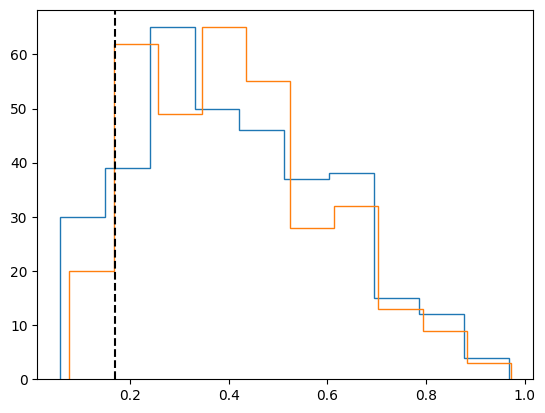

In [183]:
pl.hist(np.vstack (ksvals['co1'])[:,0], histtype='step' )  
pl.hist(np.vstack (ksvals['co2'])[:,0], histtype='step' ) 
pl.axvline(threshold, color='k', linestyle='--' ) 

In [7]:
map_repro = hp.read_map('/pscratch/sd/g/giuspugl/workstation/CO_network/CO_cyclegan1_fullsky_predictions_10.fits')

In [10]:
norm = AstroNormalization(dic_maps['co1'] .min(), dic_maps['co1'].max() ) 
md= norm.denormalize(map_repro) 


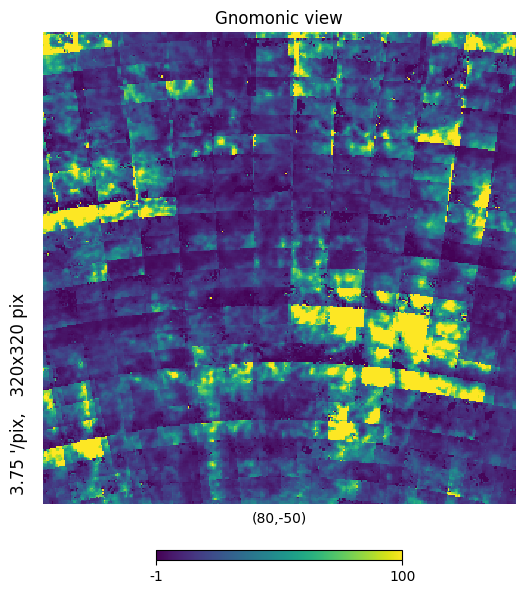

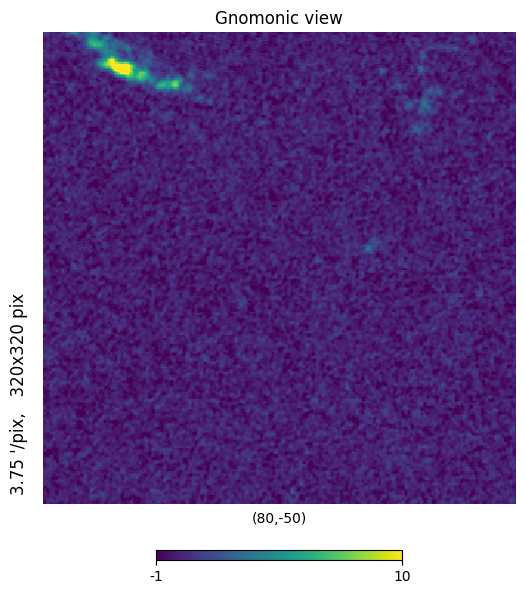

In [11]:
hp.gnomview(md,min=-1,max=100, reso=3.75, xsize=320,rot=[80,-50] ) 
hp.gnomview(dic_maps['co1'] ,min=-1,max=10, reso=3.75, xsize=320,rot=[80,-50] ) 
